## Алгоритм принятия решения

То что у нас уже есть натренированная модель, которая неплохо распознает объекты на фото это хорошо. Но это никак нам пока не поможет в классификации видео на 4 класса. Нужно разработать логику последовательных условий, результатом которой будет однозначное решение - к какому классу принадлежит видео.\
Это реализовано в скрипте `check_result_model_with_logs.py`. \
Код с большим набором if и else всегда трудно читать, особенно чужой, поэтому для удобства ниже я приведу блок-схему:




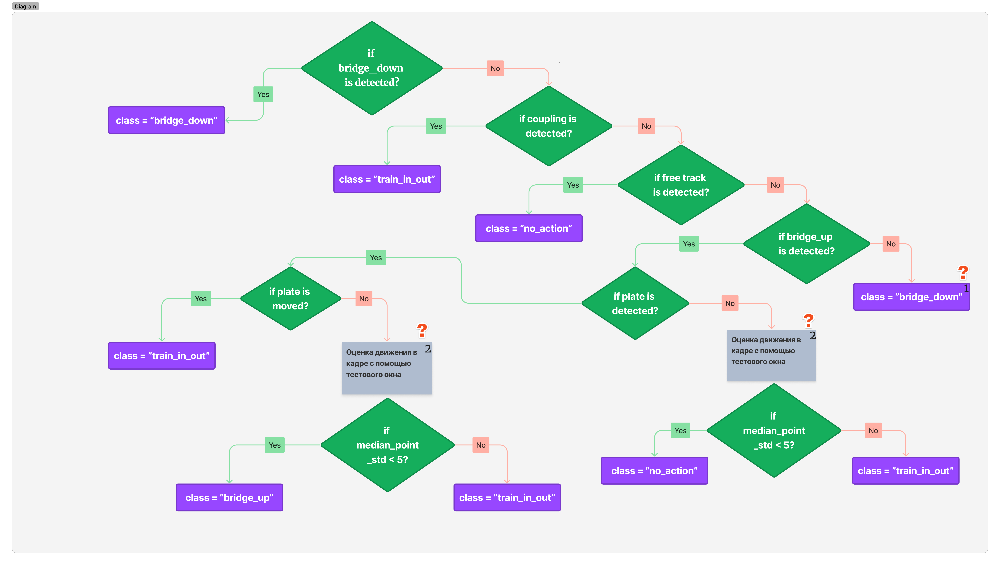

В блок схеме есть 2 неочевидных момента. Они обозначены вопросиком и цифрой. Давайте разбираться по порядку

Пункт №1\
В кадре по каким-то причинам не получилось распознать объекты. Примеры таких фреймов вы можете увидеть ниже:

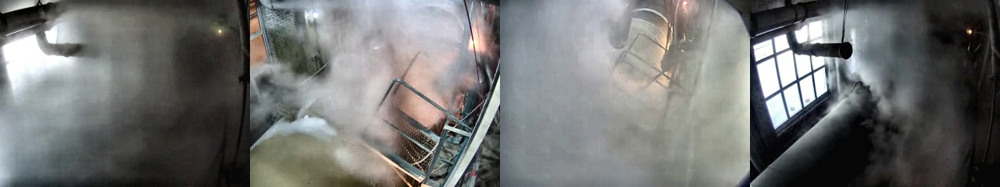

В таком случае мы делаем предположение, что сверху вагона ведутся работы => мостик опущен => class = `bridge_down`

Пункт №2\
Оценка наличия движения в кадре с помощью тестового окна.

Тестовое окно - дополнительный способ, если движение площадок не удалось зарегистировать. Таким образом мы себя страхуем, когда основной метод не сработал.\
Расположение окна меняется в зависимости от кадра. Как правило окно находится ниже и левее от объекта `bridge_up`. Но встречаются фреймы, где мостик в самом низу кадра, тогда окно левее. Также есть видео с черной полосой сверху и снизу. В таких случаях тестовое окно поднимается еще выше из черной зоны.

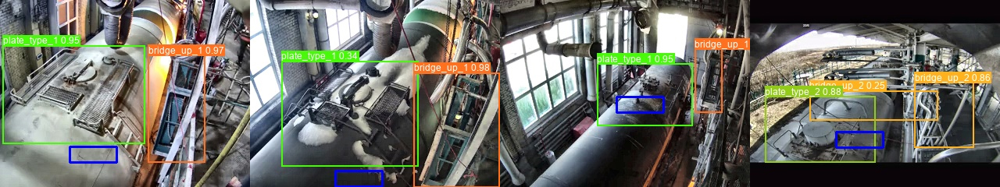

Так с расположением разобрались, на что будем смотреть в этом окне?\
В тестовом окне будут 3 контрольные точки. Будем оценивать изменение цвета пикселей.\
Идея следущая:\
Если движения в цистерн кадре нет, то цвет пикселей не должен меняться. В противном случае движущиеся объекты в тестовом окне будут вызывать постоянное изменения цвета пикселей. Этот факт = движение цистерн. Для удобства работы перед определением фрейм будет переводится из цветного изображение с 3-мя каналами RGB в изображение в оттенках серого с одним каналом, где интенсивность пикселя 0 - черный цвет, 255 - белый.

По каждой контрольной точке будем считать стандартное отклонение изменения интенсивности цвета. Логично, что там где есть движение значение стандартных отклонений будет выше. Для финальной оценки будем использовать медианное значение из 3-х. Медиана подходит лучше, чем среденее значение в данном случае. Тем самым мы невелируем влияние одного из пикселей с эскримальными значениями (ложные сигналы). Но обычно цвет контрольных точек колеблится в одинаковом диапазоне. \
Под слайдами приведен расчет значений из файлов логирования (логированием мы рассмотрим в следующей части)

Нет движения - изменение интенсивности пикселей минимально(шум)

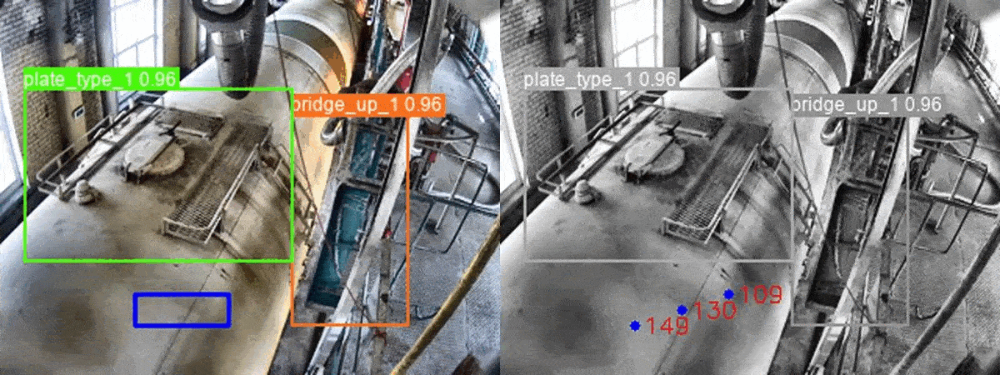
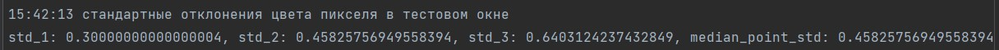

Есть движение - большой диапазон изменения цвета

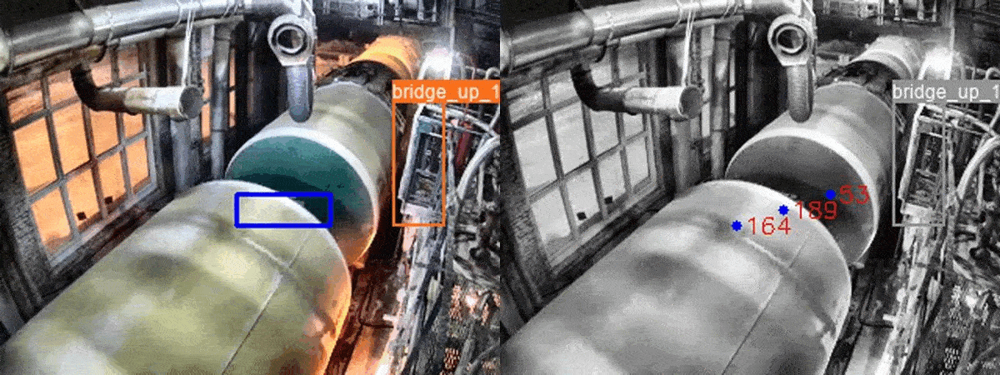
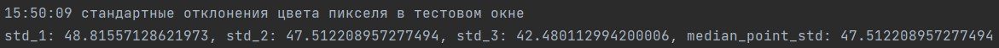

Экспериментальным путем был выбран порог разбиения: median_point_std < 5 => нет движения, median_point_std >= 5 => движение есть.

На практике данный подход очень помог увеличить качество модели.

Определение движения площадок на цистерне - основной метод.

Для определения движения используются центры bounding_boxes (рамки на объектах, которые модель обнаружила).\
Если модель определила наличие plate_type_1 или plate_type_2, то их центры регистрируются(по оси Х и по оси Y отдельно) при переходе от кадра к кадру.\
Основная идея:\
Если движение есть, то координаты по X и по Y будут равномерно либо уменьшаться, либо увеличиваться. Напротив, если движения нет, то координаты будут колебаться в плюс/минус определенном диапазоне.\
Скрин из логов для видео, которое показано выше:

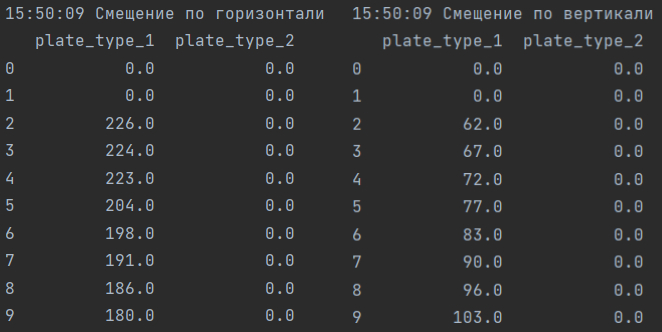

Можно посчитать разницу изменений при переходе от одного кадра к другому `diff = arr[1:] - arr[:-1]`\
Если все значения в `diff` одного знака - значит есть направленное движение, в противном случае - нет.\
В этом заключается логика принятие решение по данному признаку.

Вся логика принятия решения реализована в файле `check_result_model_with_logs.py`

## Логирование эксперимента

Логирование позволяет очень быстро получить ответы на такие вопросы как:\
Где модель ошибается?\
Почему?\
И что нужно изменить?

Для логирования использовался модуль `logger` из библиотеки `loguru`.\
Примеры лог-файлов мы можете посмотреть в папке `logs`.\
Каждый файл имеет уникальное имя по принципу: `hour-minutes_day_month_year.log`

Структура файла:

В начале файла всегда указаны веса, с которыми работала модель\


Для каждого видео указан путь и название файла, по которому его легко найти\


Какие объекты были на фреймах\
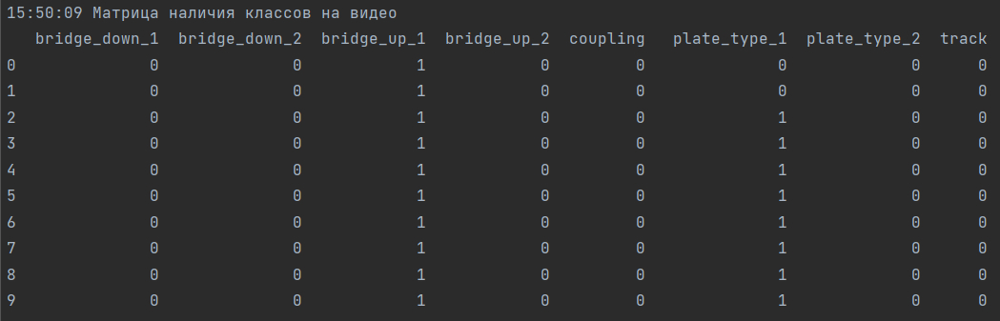

Секция определения движения. С этим вы уже знакомы. 
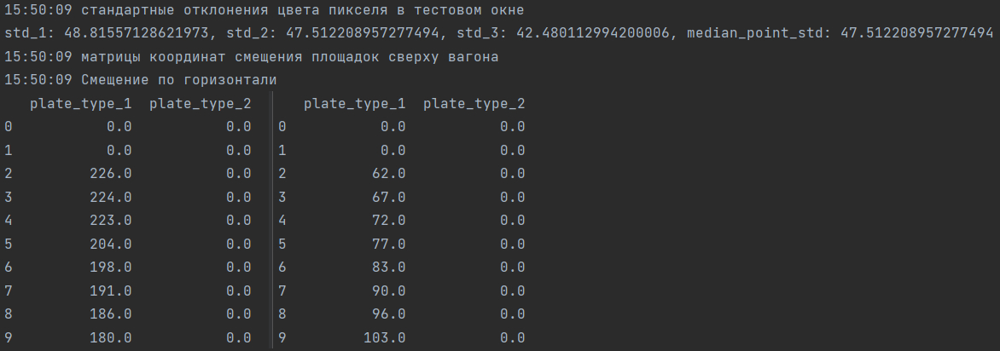

Опорные тезисы принятия решения и итоговый результат
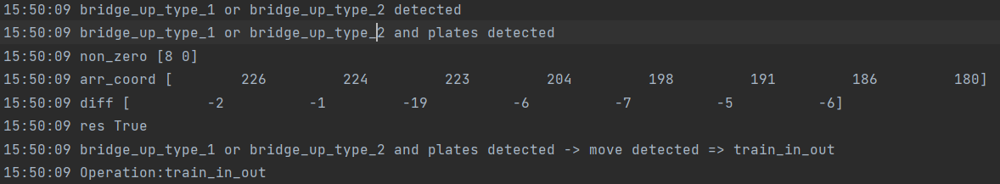
Обратите внимание, что здесь движение определилось по смещению площадок в кадре, поэтому проверка в тестовом окне не производилась.

Принятие решения по тестовому окну\
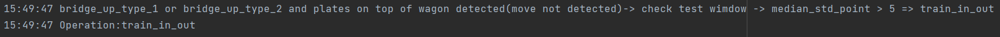

Затраченное время на обработку одного видео (в данном случае 10 кадров с видео)\
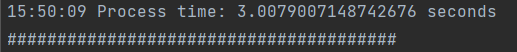

В конце каждого файла представленна статистика по количеству верно классифицированных видео и какие/сколько объектов всего определено
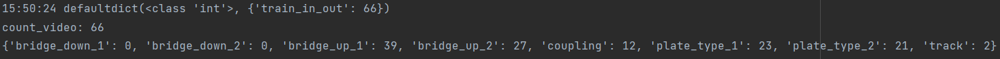

С логированием эксперимента непонятное поведение модели становится очевидным, а локализовать проблему быстро и несложно.

## Результаты модели

Напомним, что после разбиения у нас получилось такое соотношение видеороликов:\
train - 255 (кадры из видео участвовали в разметке)\
test - 241

Запустим проверку модели на каждой выборке и посмотрим на classification_report.\
Реализация в файле `get_classification_report.py`

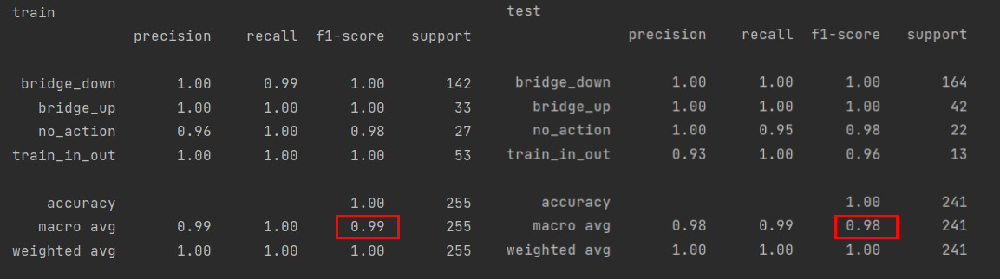
Метрика F1(macro) выделена красным

Проверка проводилась на 10 кадрах с ролика.\
Время проверки одного видео 2,5 - 3,2 секунды.\
В тоже время детекция объектов на одном кадре занимает 100 - 150 мс.\
Подготовка к при переходе от одного видео занимает половину времени, возможно это можно оптимизировать и как-то ускорить процесс.\

## Выводы

- Сочетание простой модели YOLO 8n и обычной логики показали неплохой результат.
- Подход к сэмплированию - рабочий. Он позволяет не только снизить количество фотографий для разметки, но повышает качество тренировочной выборки. Данный подход можно использовать и в других задачах видеоаналитики.
- Вся модель в целом может быть отправной точкой в оптимизации логистики. Собрав данные с разных локаций, можно определить сколько обычно уходит времени на определенные операции. Выяснить почему на некоторых локациях операции занимают больше времени, чем на других. Увидеть проблемы, наладить процессы. Это позволить уменьшить простой подвижного состава и снизить расходы на его аренду. 